# Predicting Mortgage Backed Securities Prepayment Risk Prediction 

## Importing Data & Needed Libraries

In [505]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns 
import networkx as nx
import statsmodels.api as sm
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder
import warnings
warnings.filterwarnings("ignore")
import matplotlib
warnings.filterwarnings("always")

%matplotlib inline 

In [506]:
data = pd.read_csv('LoanExport.csv')
data.head(20)

<ipython-input-506-674adbca6759>:1: DtypeWarning:

Columns (18) have mixed types. Specify dtype option on import or set low_memory=False.



,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,...,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
0,0,199902,N,202901,16974,25,1,O,89,27,...,60400,F199Q1268030,P,360,2,FL,WASHINGTONMUTUALBANK,0,0,52
1,0,199902,N,202901,19740,0,1,O,73,17,...,80200,F199Q1015092,N,360,1,FT,CHASEHOMEFINANCELLC,0,0,144
2,0,199902,N,202901,29940,0,1,O,75,16,...,66000,F199Q1266886,N,360,2,FL,WASHINGTONMUTUALBANK,0,0,67
3,0,199902,N,202901,31084,0,1,O,76,14,...,90700,F199Q1178167,N,360,2,GM,GMACMTGECORP,0,0,35
4,0,199902,N,202901,35644,0,1,O,78,18,...,7600,F199Q1178517,N,360,2,GM,GMACMTGECORP,0,0,54
5,0,199902,N,202901,X,25,1,O,89,40,...,80400,F199Q1224802,N,360,2,Ot,Other servicers,0,0,42
6,0,199902,N,202901,X,25,1,O,90,21,...,53100,F199Q1291436,P,360,1,RE,Other servicers,0,0,44
7,0,199902,X,202901,36740,0,1,O,72,20,...,32800,F199Q1001824,N,360,1,NO,WELLSFARGOBANKNA,1,3,145
8,0,199902,Y,202710,25540,30,1,O,95,38,...,6400,F199Q1079744,P,345,1,Ot,Other servicers,0,0,64
9,0,199902,Y,202901,48620,30,1,O,95,27,...,67000,F199Q1196318,P,360,1,Ot,WELLSFARGOBANKNA,1,104,212


## Defining Needed Functions for EDA

In [507]:
def draw_histogram(col,plottitle,xlabel,ylabel):
  plt.figure(figsize=(30,10))
  plt.hist(data[col],edgecolor='black')
  plt.title(plottitle)
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)
  plt.show()
# function to draw histogram to know the density of any categorical data

In [508]:
def draw_boxplot(col):
  sns.boxplot(data[col]) 


In [509]:
def draw_piechart(col,label):
  plt.figure(figsize=(10,10))
  plt.pie(data[col].value_counts(),shadow=True ,autopct='%.3f',labels=label)
  plt.show()

In [510]:
def draw_scatterplot(col1,col2):
  plt.scatter(data[col1],data[col2])


In [511]:
def calc_linearsummary(feature, target):
  y = data[target]
  x = data[feature]
  x = sm.add_constant(x)
  model = sm.OLS(y, x).fit()
  print(model.summary())

In [512]:
def draw_join_plot(colx,coly):
  sns.jointplot(x=colx,y=coly,kind='reg')

In [513]:
def handle_outlier(col):
  sorted(col)
  Q1,Q3=col.quantile([0.25,0.75])
  IQR=Q3-Q1
  lower=Q1-(1.5*IQR)
  upper=Q3+(1.5*IQR)
  return lower , upper

In [514]:
def label_encoding(col):
  label_encoder = preprocessing.LabelEncoder()
  data[col]= label_encoder.fit_transform(data[col])


In [515]:
def one_hot_encoding(cols):
  one_hot_encoded_data = pd.get_dummies(data, columns = cols)
  return one_hot_encoded_data

## Data Preprocessing & EDA

In [516]:
data.shape

(291451, 28)

In [517]:
# Checking informations about our features
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291451 entries, 0 to 291450
Data columns (total 28 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   CreditScore         291451 non-null  int64  
 1   FirstPaymentDate    291451 non-null  int64  
 2   FirstTimeHomebuyer  291451 non-null  object 
 3   MaturityDate        291451 non-null  int64  
 4   MSA                 291451 non-null  object 
 5   MIP                 291451 non-null  int64  
 6   Units               291451 non-null  int64  
 7   Occupancy           291451 non-null  object 
 8   OCLTV               291451 non-null  int64  
 9   DTI                 291451 non-null  int64  
 10  OrigUPB             291451 non-null  int64  
 11  LTV                 291451 non-null  int64  
 12  OrigInterestRate    291451 non-null  float64
 13  Channel             291451 non-null  object 
 14  PPM                 291451 non-null  object 
 15  ProductType         291451 non-nul

In [518]:
# Checking for missing values 
data.isnull().sum()

CreditScore               0
FirstPaymentDate          0
FirstTimeHomebuyer        0
MaturityDate              0
MSA                       0
MIP                       0
Units                     0
Occupancy                 0
OCLTV                     0
DTI                       0
OrigUPB                   0
LTV                       0
OrigInterestRate          0
Channel                   0
PPM                       0
ProductType               0
PropertyState             0
PropertyType              0
PostalCode                0
LoanSeqNum                0
LoanPurpose               0
OrigLoanTerm              0
NumBorrowers              0
SellerName            24994
ServicerName              0
EverDelinquent            0
MonthsDelinquent          0
MonthsInRepayment         0
dtype: int64

In [519]:
#Check if there's any categorical features in our data 
data.dtypes

CreditScore             int64
FirstPaymentDate        int64
FirstTimeHomebuyer     object
MaturityDate            int64
MSA                    object
MIP                     int64
Units                   int64
Occupancy              object
OCLTV                   int64
DTI                     int64
OrigUPB                 int64
LTV                     int64
OrigInterestRate      float64
Channel                object
PPM                    object
ProductType            object
PropertyState          object
PropertyType           object
PostalCode             object
LoanSeqNum             object
LoanPurpose            object
OrigLoanTerm            int64
NumBorrowers           object
SellerName             object
ServicerName           object
EverDelinquent          int64
MonthsDelinquent        int64
MonthsInRepayment       int64
dtype: object

In [520]:
# Convert date feature to datetime format 
data['MaturityDate'] = data['MaturityDate'].apply(lambda x: pd.to_datetime(str(x), format='%Y%m'))

In [521]:
data['FirstPaymentDate'] = data['FirstPaymentDate'].apply(lambda x: pd.to_datetime(str(x), format='%Y%m'))

In [522]:
#Visualize the change on dtypes of features
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291451 entries, 0 to 291450
Data columns (total 28 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   CreditScore         291451 non-null  int64         
 1   FirstPaymentDate    291451 non-null  datetime64[ns]
 2   FirstTimeHomebuyer  291451 non-null  object        
 3   MaturityDate        291451 non-null  datetime64[ns]
 4   MSA                 291451 non-null  object        
 5   MIP                 291451 non-null  int64         
 6   Units               291451 non-null  int64         
 7   Occupancy           291451 non-null  object        
 8   OCLTV               291451 non-null  int64         
 9   DTI                 291451 non-null  int64         
 10  OrigUPB             291451 non-null  int64         
 11  LTV                 291451 non-null  int64         
 12  OrigInterestRate    291451 non-null  float64       
 13  Channel             291451 no

In [523]:
#View description of all of our features 
num1_cols = data.describe(include='all')
num1_cols

<ipython-input-523-73e8b8f9509f>:2: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.

<ipython-input-523-73e8b8f9509f>:2: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



,CreditScore,FirstPaymentDate,FirstTimeHomebuyer,MaturityDate,MSA,MIP,Units,Occupancy,OCLTV,DTI,...,PostalCode,LoanSeqNum,LoanPurpose,OrigLoanTerm,NumBorrowers,SellerName,ServicerName,EverDelinquent,MonthsDelinquent,MonthsInRepayment
count,291451.000000,291451,291451,291451,291451,291451.000000,291451.000000,291451,291451.000000,291451.000000,...,291451,291451,291451,291451.000000,291451,266457,291451,291451.000000,291451.000000,291451.000000
unique,NaN,66,3,96,392,NaN,NaN,3,NaN,NaN,...,1767,291451,3,NaN,3,20,20,NaN,NaN,NaN
top,NaN,1999-05-01 00:00:00,N,2029-04-01 00:00:00,X,NaN,NaN,O,NaN,NaN,...,94500,F199Q1268030,P,NaN,2,Ot,Other servicers,NaN,NaN,NaN
freq,NaN,104071,184154,104210,39100,NaN,NaN,276131,NaN,NaN,...,2582,1,123404,NaN,187335,76943,64043,NaN,NaN,NaN
first,NaN,1999-01-01 00:00:00,NaN,2024-02-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,2013-03-01 00:00:00,NaN,2043-02-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,708.936991,NaN,NaN,NaN,NaN,9.216685,1.026022,NaN,76.960529,30.033453,...,NaN,NaN,NaN,359.835375,NaN,NaN,NaN,0.197848,1.837729,60.805291
std,68.408791,NaN,NaN,NaN,NaN,12.648273,0.202986,NaN,15.236154,13.203974,...,NaN,NaN,NaN,2.286939,NaN,NaN,NaN,0.398378,8.809392,46.142599
min,0.000000,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,0.000000,...,NaN,NaN,NaN,301.000000,NaN,NaN,NaN,0.000000,0.000000,1.000000
25%,675.000000,NaN,NaN,NaN,NaN,0.000000,1.000000,NaN,70.000000,22.000000,...,NaN,NaN,NaN,360.000000,NaN,NaN,NaN,0.000000,0.000000,34.000000


In [524]:
#Count number of distinct elements in axis 0.
data.nunique()

CreditScore              370
FirstPaymentDate          66
FirstTimeHomebuyer         3
MaturityDate              96
MSA                      392
MIP                       37
Units                      5
Occupancy                  3
OCLTV                    102
DTI                       66
OrigUPB                  375
LTV                       97
OrigInterestRate         254
Channel                    4
PPM                        3
ProductType                1
PropertyState             53
PropertyType               7
PostalCode              1767
LoanSeqNum            291451
LoanPurpose                3
OrigLoanTerm              61
NumBorrowers               3
SellerName                20
ServicerName              20
EverDelinquent             2
MonthsDelinquent         174
MonthsInRepayment        212
dtype: int64

In [525]:
data["EverDelinquent"].value_counts()

0    233788
1     57663
Name: EverDelinquent, dtype: int64

In [526]:
print("Seller Name size: \n",data.SellerName.value_counts(),"\n\n")

Seller Name size: 
 Ot    76943
CO    34479
FL    25573
FI    24581
ST    22243
NO    16184
OL     7776
PR     7365
BA     7093
GM     6566
BI     6407
G      4734
CH     4599
CR     4459
FT     4105
WA     3139
AC     3076
HO     2970
PN     2407
RE     1758
Name: SellerName, dtype: int64 




In [527]:
#Return unique values based on a hash table.
data['FirstTimeHomebuyer'].unique()

array(['N', 'X', 'Y'], dtype=object)

In [528]:
# X means No
# Y means Yes
# X means Unknown value 

In [529]:
data['PPM'].unique()

array(['N', 'X', 'Y'], dtype=object)

In [530]:
data['NumBorrowers'].unique()
# X  means unknown value

array(['2', '1', 'X '], dtype=object)

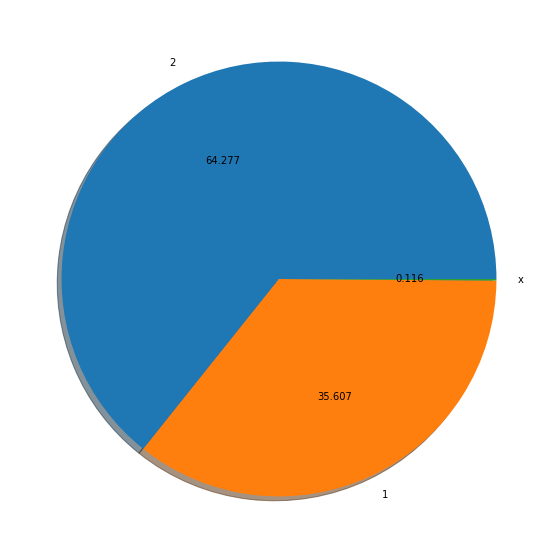

In [531]:
#draw piechart of NumBorrowers to see the distribution of its values 
label_arr=['2','1','x']
draw_piechart('NumBorrowers',label_arr)

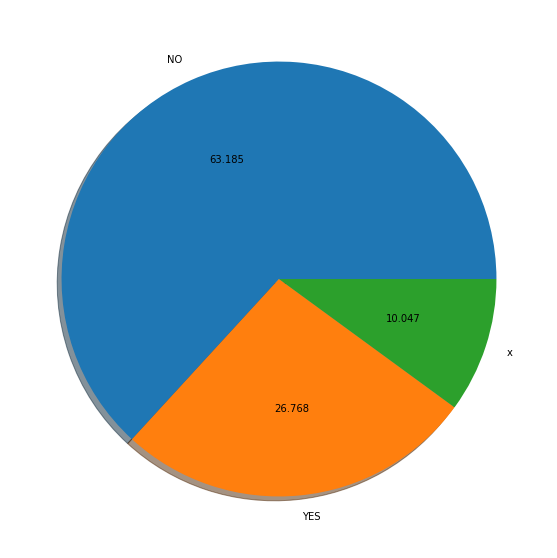

In [532]:
#draw piechart of FirstTimeHomebuyer to see the distribution of its values 

label_arr=['NO','YES','x']
draw_piechart('FirstTimeHomebuyer',label_arr)

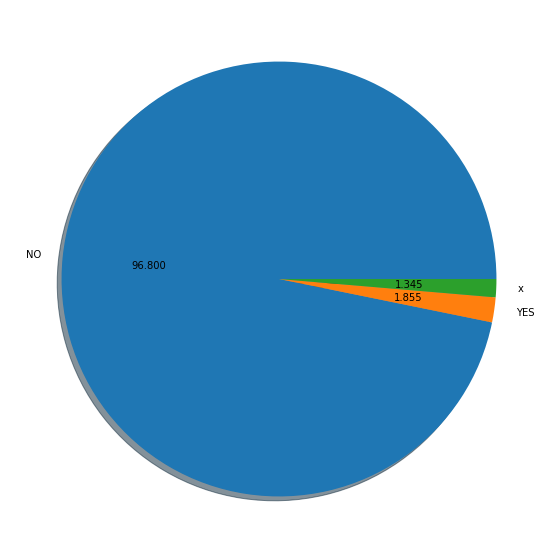

In [533]:
#draw piechart of PPM to see the distribution of its values 
label_arr=['NO','YES','x']
draw_piechart('PPM',label_arr)

In [534]:
data['Occupancy'].unique()

array(['O', 'I', 'S'], dtype=object)

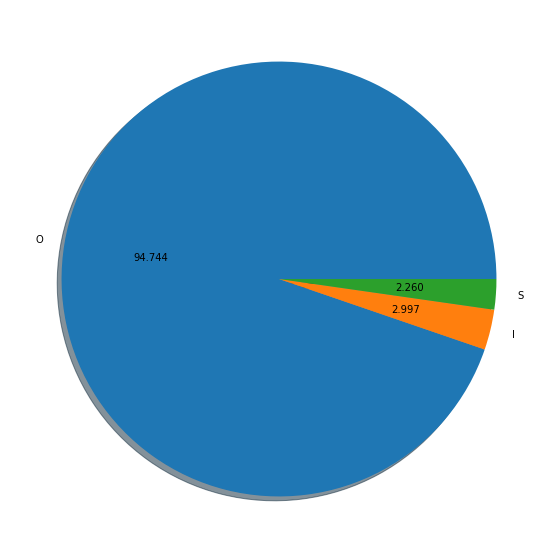

In [535]:
#draw piechart of Occupancy to see the distribution of its values 
label_arr=['O','I','S']
draw_piechart('Occupancy',label_arr)

In [536]:
data['PostalCode'].value_counts()

94500    2582
30000    2374
48100    2166
85200    2155
48000    1976
         ... 
79500       1
26600       1
41400       1
36900       1
41300       1
Name: PostalCode, Length: 1767, dtype: int64

In [537]:
data['LoanPurpose'].unique()

array(['P', 'N', 'C'], dtype=object)

In [538]:
data['LoanPurpose'].value_counts()

P    123404
N    110036
C     58011
Name: LoanPurpose, dtype: int64

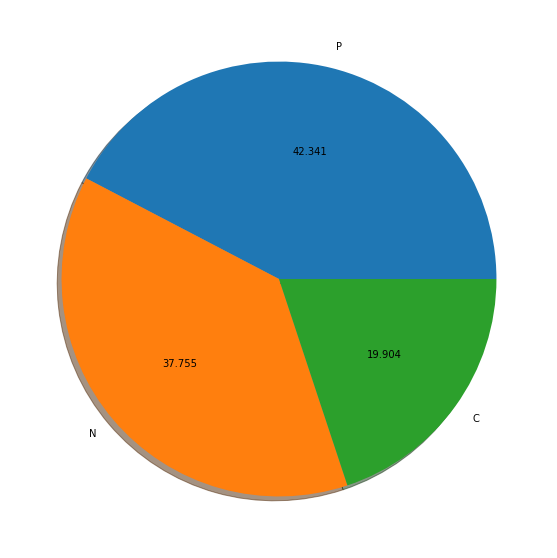

In [539]:
#draw piechart of LoanPurpose to see the distribution of its values 

label_arr=['P','N','C']
draw_piechart('LoanPurpose',label_arr)

In [540]:
data['Channel'].unique()

array(['T', 'R', 'C', 'B'], dtype=object)

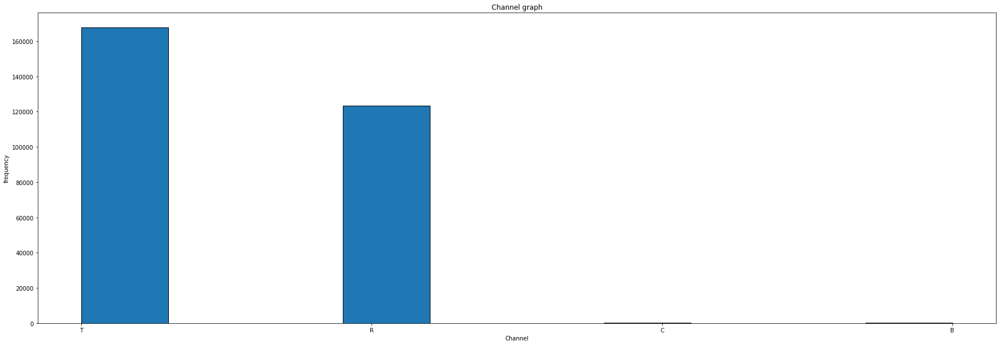

In [541]:
# Draw histogram to know the density of out categorical data: Channel
draw_histogram('Channel','Channel graph','Channel','frequency')

In [542]:
#Convert categorial feature to numerical one by label_encoding function defined earlier
label_encoding('Channel')

x is unknown neither it is yes or no so we will drop x rows 

In [543]:
data['PropertyState'].unique()

array(['IL', 'CO', 'KS', 'CA', 'NJ', 'WI', 'FL', 'CT', 'GA', 'TX', 'MD',
       'MA', 'SC', 'WY', 'NC', 'AZ', 'IN', 'MS', 'NY', 'WA', 'AR', 'VA',
       'MN', 'LA', 'PA', 'OR', 'RI', 'UT', 'MI', 'TN', 'AL', 'MO', 'IA',
       'NM', 'NV', 'VT', 'OH', 'NE', 'HI', 'ID', 'PR', 'DC', 'GU', 'KY',
       'NH', 'SD', 'ME', 'MT', 'OK', 'WV', 'DE', 'ND', 'AK'], dtype=object)

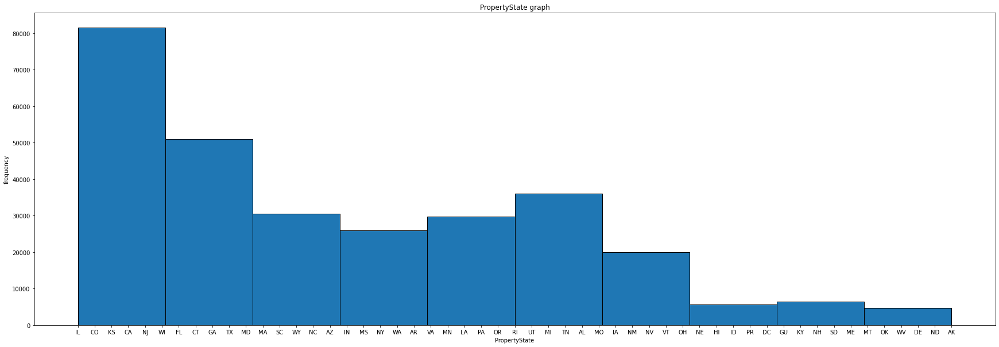

In [544]:
# Draw histogram to know the density of out categorical data: PropertyState
draw_histogram('PropertyState','PropertyState graph','PropertyState','frequency')

In [545]:
#Convert it to numerical 
label_encoding('PropertyState')

In [546]:
data['PropertyType'].unique()

array(['SF', 'PU', 'CO', 'MH', 'CP', 'LH', 'X '], dtype=object)

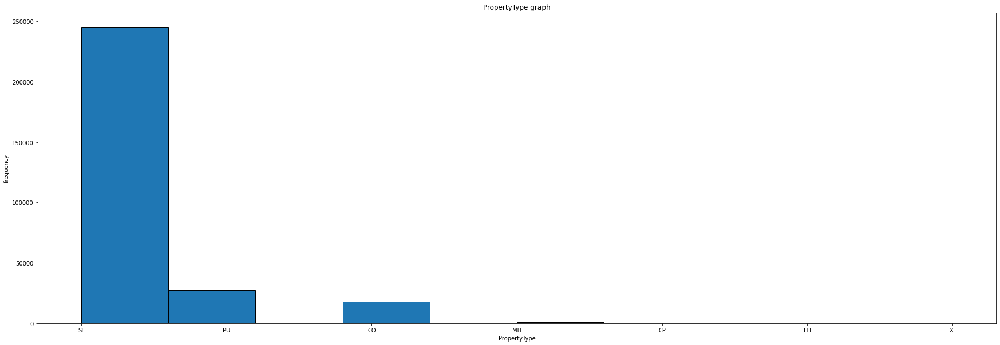

In [547]:
# Draw histogram to know the density of out categorical data: PropertyType

draw_histogram('PropertyType','PropertyType graph','PropertyType','frequency')

In [548]:
#Convert it to numerical 
label_encoding('PropertyType')

## Data Visualization

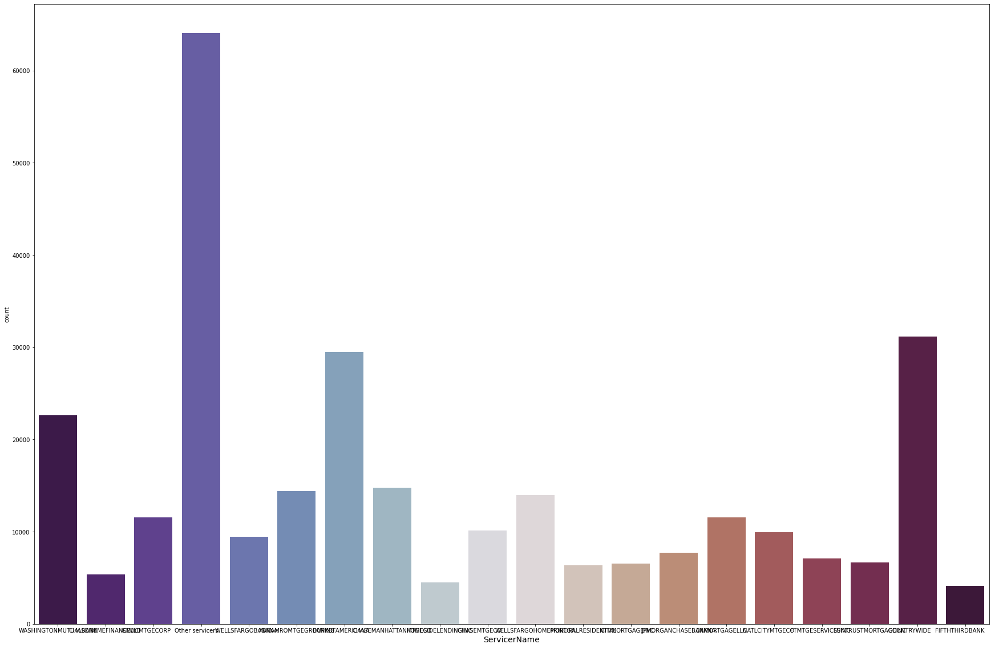

In [549]:
plt.figure(figsize=(30,20))
sns.countplot(x='ServicerName',data=data,palette="twilight_shifted")
plt.xlabel("ServicerName",fontsize=14)
plt.show()

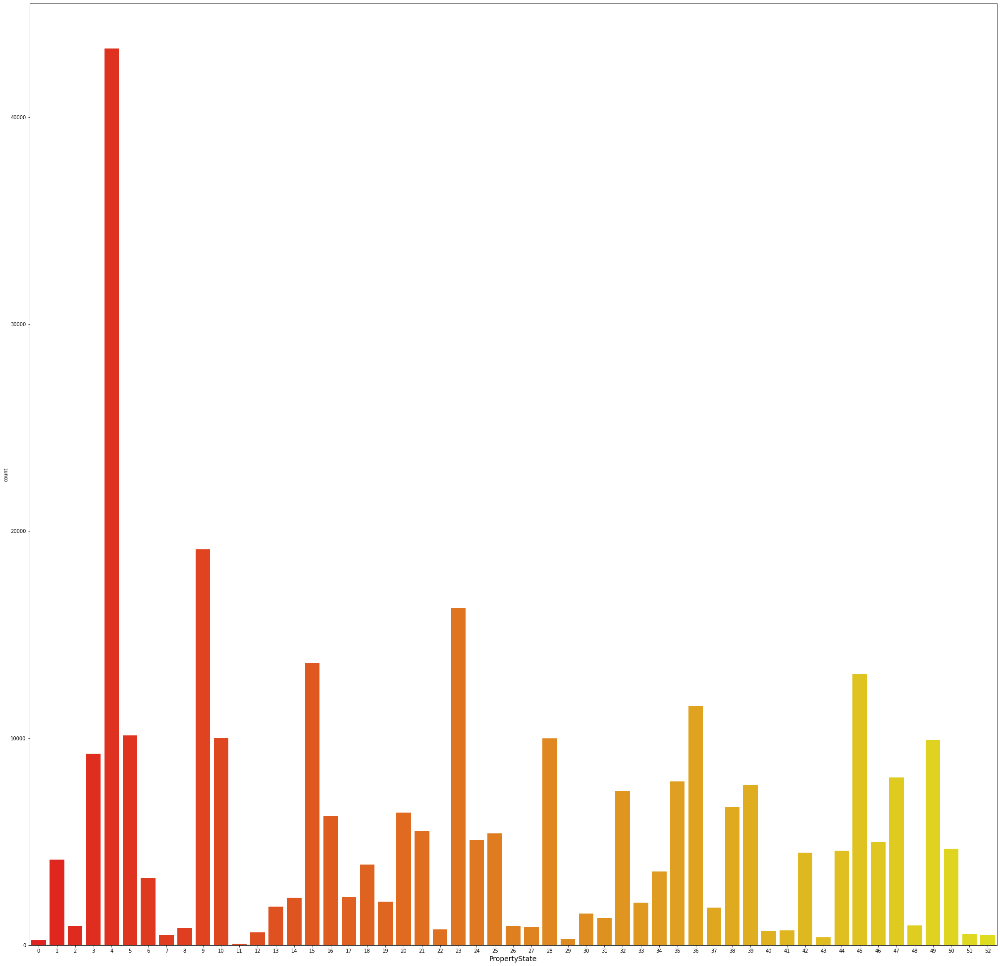

In [550]:
plt.figure(figsize=(35,35))
sns.countplot(x='PropertyState',data=data,palette="autumn")
plt.xlabel("PropertyState",fontsize=14)
plt.show()

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



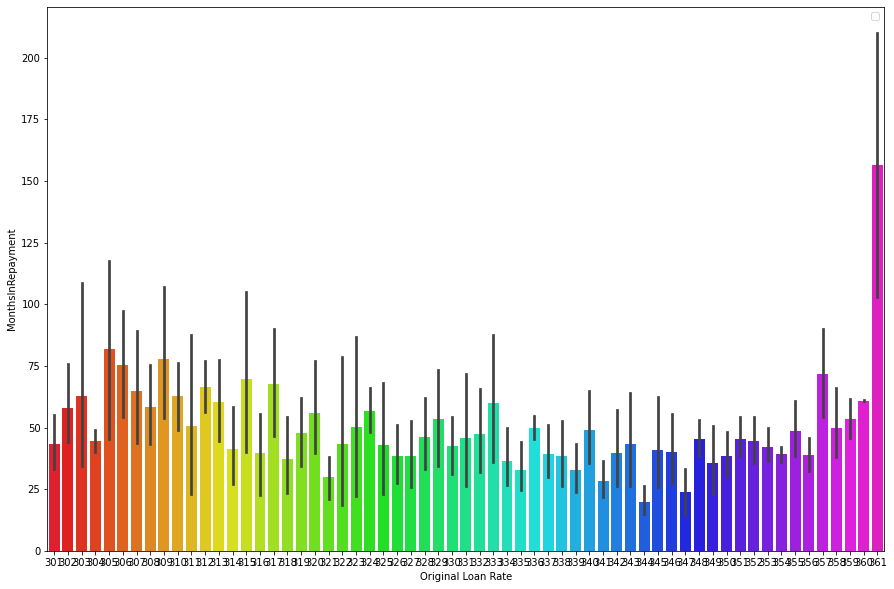

In [551]:
plt.figure(figsize=(15,10))
sns.barplot('OrigLoanTerm','MonthsInRepayment',data=data,palette='gist_rainbow')
plt.xlabel('Original Loan Rate')
plt.legend()
plt.show()

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



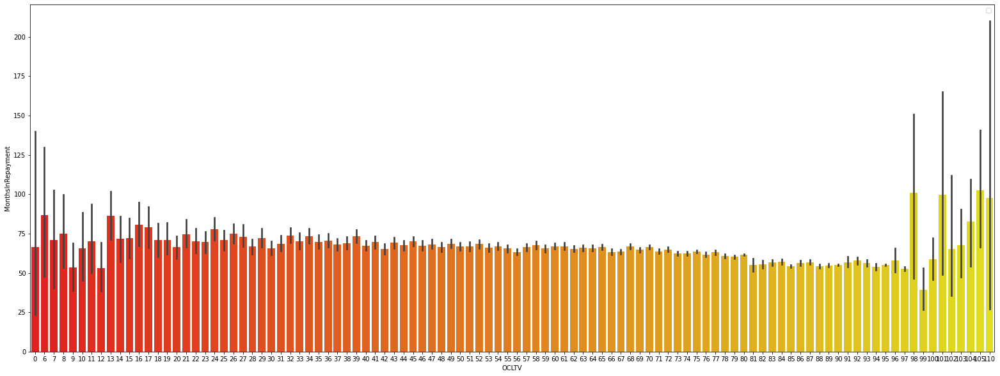

In [552]:
plt.figure(figsize=(27,10))
sns.barplot('OCLTV','MonthsInRepayment',data=data,palette='autumn')
plt.xlabel('OCLTV')
plt.legend()
plt.show()

In [553]:
#convert LoanPurpose and FirstTimeHomebuyer to numerical data by get_dummies function
encoded_data = pd.get_dummies(data['LoanPurpose'], prefix='LoanPurpose')
encoded_data2 = pd.get_dummies(data['FirstTimeHomebuyer'], prefix='FirstTimeHomebuyer')
data_temp = pd.concat([data, encoded_data], axis=1)
data=pd.concat([data_temp,encoded_data2], axis =1)
data.drop('LoanPurpose', axis=1,inplace=True)
data.drop('FirstTimeHomebuyer', axis =1 , inplace=True)

## Quick Feature Engineering 

In [554]:
data.columns

Index(['CreditScore', 'FirstPaymentDate', 'MaturityDate', 'MSA', 'MIP',
       'Units', 'Occupancy', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'Channel', 'PPM', 'ProductType', 'PropertyState',
       'PropertyType', 'PostalCode', 'LoanSeqNum', 'OrigLoanTerm',
       'NumBorrowers', 'SellerName', 'ServicerName', 'EverDelinquent',
       'MonthsDelinquent', 'MonthsInRepayment', 'LoanPurpose_C',
       'LoanPurpose_N', 'LoanPurpose_P', 'FirstTimeHomebuyer_N',
       'FirstTimeHomebuyer_X', 'FirstTimeHomebuyer_Y'],
      dtype='object')

In [555]:
# Eliminating useless features 
data.drop(['FirstTimeHomebuyer_X','FirstTimeHomebuyer_N','ServicerName','SellerName','NumBorrowers','PropertyType','PropertyState','ProductType','PPM','Channel','Occupancy','MSA','MaturityDate','FirstPaymentDate'], inplace=True,axis=1)


In [556]:
data.head()

,CreditScore,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,PostalCode,LoanSeqNum,OrigLoanTerm,EverDelinquent,MonthsDelinquent,MonthsInRepayment,LoanPurpose_C,LoanPurpose_N,LoanPurpose_P,FirstTimeHomebuyer_Y
0,0,25,1,89,27,117000,89,6.750,60400,F199Q1268030,360,0,0,52,0,0,1,0
1,0,0,1,73,17,109000,73,6.500,80200,F199Q1015092,360,0,0,144,0,1,0,0
2,0,0,1,75,16,88000,75,6.875,66000,F199Q1266886,360,0,0,67,0,1,0,0
3,0,0,1,76,14,160000,76,6.875,90700,F199Q1178167,360,0,0,35,0,1,0,0
4,0,0,1,78,18,109000,78,7.125,7600,F199Q1178517,360,0,0,54,0,1,0,0


In [557]:
data.isnull().sum()

CreditScore             0
MIP                     0
Units                   0
OCLTV                   0
DTI                     0
OrigUPB                 0
LTV                     0
OrigInterestRate        0
PostalCode              0
LoanSeqNum              0
OrigLoanTerm            0
EverDelinquent          0
MonthsDelinquent        0
MonthsInRepayment       0
LoanPurpose_C           0
LoanPurpose_N           0
LoanPurpose_P           0
FirstTimeHomebuyer_Y    0
dtype: int64

In [558]:
#check nulls precentage to be more sure 
data.isnull().sum()*100/data.shape[0] 

CreditScore             0.0
MIP                     0.0
Units                   0.0
OCLTV                   0.0
DTI                     0.0
OrigUPB                 0.0
LTV                     0.0
OrigInterestRate        0.0
PostalCode              0.0
LoanSeqNum              0.0
OrigLoanTerm            0.0
EverDelinquent          0.0
MonthsDelinquent        0.0
MonthsInRepayment       0.0
LoanPurpose_C           0.0
LoanPurpose_N           0.0
LoanPurpose_P           0.0
FirstTimeHomebuyer_Y    0.0
dtype: float64

In [559]:
data.drop(['PostalCode','LoanSeqNum'], axis=1,inplace=True)

In [560]:
data.info()
#no more categorical variables 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291451 entries, 0 to 291450
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   CreditScore           291451 non-null  int64  
 1   MIP                   291451 non-null  int64  
 2   Units                 291451 non-null  int64  
 3   OCLTV                 291451 non-null  int64  
 4   DTI                   291451 non-null  int64  
 5   OrigUPB               291451 non-null  int64  
 6   LTV                   291451 non-null  int64  
 7   OrigInterestRate      291451 non-null  float64
 8   OrigLoanTerm          291451 non-null  int64  
 9   EverDelinquent        291451 non-null  int64  
 10  MonthsDelinquent      291451 non-null  int64  
 11  MonthsInRepayment     291451 non-null  int64  
 12  LoanPurpose_C         291451 non-null  uint8  
 13  LoanPurpose_N         291451 non-null  uint8  
 14  LoanPurpose_P         291451 non-null  uint8  
 15  

In [561]:
data.head()

,CreditScore,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,OrigLoanTerm,EverDelinquent,MonthsDelinquent,MonthsInRepayment,LoanPurpose_C,LoanPurpose_N,LoanPurpose_P,FirstTimeHomebuyer_Y
0,0,25,1,89,27,117000,89,6.750,360,0,0,52,0,0,1,0
1,0,0,1,73,17,109000,73,6.500,360,0,0,144,0,1,0,0
2,0,0,1,75,16,88000,75,6.875,360,0,0,67,0,1,0,0
3,0,0,1,76,14,160000,76,6.875,360,0,0,35,0,1,0,0
4,0,0,1,78,18,109000,78,7.125,360,0,0,54,0,1,0,0


In [562]:
data.describe()

,CreditScore,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,OrigLoanTerm,EverDelinquent,MonthsDelinquent,MonthsInRepayment,LoanPurpose_C,LoanPurpose_N,LoanPurpose_P,FirstTimeHomebuyer_Y
count,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000,291451.000000
mean,708.936991,9.216685,1.026022,76.960529,30.033453,124940.387921,76.937986,6.926547,359.835375,0.197848,1.837729,60.805291,0.199042,0.377545,0.423413,0.100470
std,68.408791,12.648273,0.202986,15.236154,13.203974,53657.440624,15.225298,0.343541,2.286939,0.398378,8.809392,46.142599,0.399280,0.484774,0.494100,0.300626
min,0.000000,0.000000,0.000000,0.000000,0.000000,8000.000000,0.000000,4.000000,301.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,675.000000,0.000000,1.000000,70.000000,22.000000,83000.000000,70.000000,6.750000,360.000000,0.000000,0.000000,34.000000,0.000000,0.000000,0.000000,0.000000
50%,717.000000,0.000000,1.000000,80.000000,31.000000,117000.000000,80.000000,6.875000,360.000000,0.000000,0.000000,48.000000,0.000000,0.000000,0.000000,0.000000
75%,753.000000,25.000000,1.000000,90.000000,39.000000,160000.000000,90.000000,7.125000,360.000000,0.000000,0.000000,63.000000,0.000000,1.000000,1.000000,0.000000
max,849.000000,55.000000,4.000000,110.000000,65.000000,497000.000000,103.000000,12.350000,361.000000,1.000000,180.000000,212.000000,1.000000,1.000000,1.000000,1.000000


In [563]:
data.corr()
#draw the correlation matrix to see the relationship between variables

,CreditScore,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,OrigLoanTerm,EverDelinquent,MonthsDelinquent,MonthsInRepayment,LoanPurpose_C,LoanPurpose_N,LoanPurpose_P,FirstTimeHomebuyer_Y
CreditScore,1.000000,-0.164376,0.002808,-0.190848,-0.098740,0.003770,-0.191080,-0.119472,-0.008075,-0.207204,-0.150266,-0.005127,0.012689,-0.005176,-0.005175,-0.049881
MIP,-0.164376,1.000000,-0.042111,0.694789,0.111603,0.006729,0.695888,0.124544,0.014834,0.059993,0.051204,-0.087802,-0.326432,-0.156375,0.417212,0.264119
Units,0.002808,-0.042111,1.000000,-0.046133,0.012887,0.043827,-0.046032,0.074070,0.005348,0.010163,-0.004573,0.025594,0.002475,0.020492,-0.022105,-0.011075
OCLTV,-0.190848,0.694789,-0.046133,1.000000,0.114853,0.106273,0.999470,0.095268,0.018560,0.065528,0.059811,-0.094299,-0.310735,-0.142061,0.390483,0.242708
DTI,-0.098740,0.111603,0.012887,0.114853,1.000000,0.063640,0.114468,0.105216,0.028005,0.062109,0.040830,-0.007732,-0.003264,-0.063646,0.065082,0.056925
OrigUPB,0.003770,0.006729,0.043827,0.106273,0.063640,1.000000,0.105722,-0.128563,-0.008008,-0.067605,-0.067243,-0.211698,-0.043511,0.014162,0.021267,-0.031918
LTV,-0.191080,0.695888,-0.046032,0.999470,0.114468,0.105722,1.000000,0.095520,0.018477,0.065735,0.059930,-0.094596,-0.310805,-0.141873,0.390355,0.242869
OrigInterestRate,-0.119472,0.124544,0.074070,0.095268,0.105216,-0.128563,0.095520,1.000000,0.010794,0.060418,0.051706,-0.120378,-0.013966,-0.015458,0.026452,0.038733
OrigLoanTerm,-0.008075,0.014834,0.005348,0.018560,0.028005,-0.008008,0.018477,0.010794,1.000000,0.010348,0.006567,0.016591,0.016022,-0.032148,0.018593,0.014915
EverDelinquent,-0.207204,0.059993,0.010163,0.065528,0.062109,-0.067605,0.065735,0.060418,0.010348,1.000000,0.420048,0.232497,0.017766,0.004577,-0.018847,0.002109


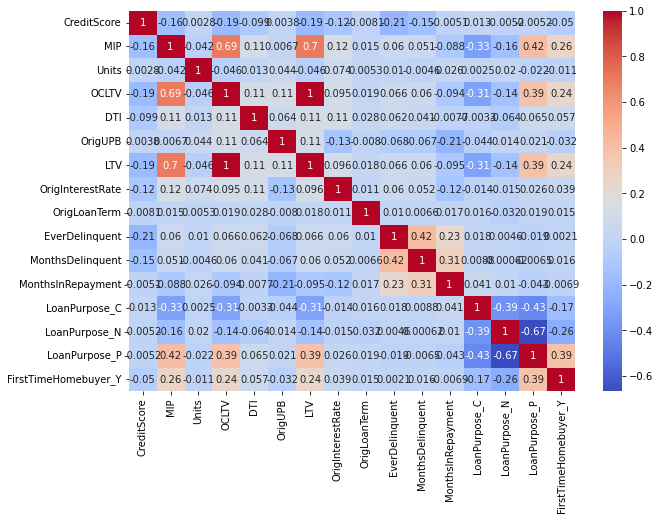

In [564]:
#sns.heatmap(data.corr(),cmap='coolwarm',annot=True)
#show the correlation between data's features using heat map


# Generate correlation matrix
corr_matrix = data.corr()

# Set figure size
plt.figure(figsize=(10,7))

# Create heatmap with correlation matrix
sns.heatmap(corr_matrix, cmap='coolwarm', annot=True)

# Show plot
plt.show()


<AxesSubplot:>

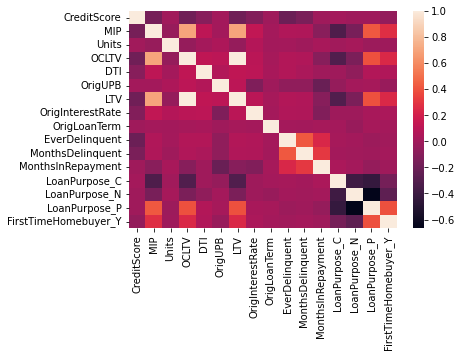

In [565]:
sns.heatmap(data.corr(),cmap='rocket')

## Handling Outliers

<AxesSubplot:>

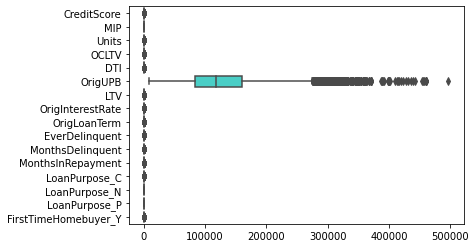

In [566]:
sns.boxplot(data=data,palette='rainbow',orient='h')
#box plot to all features to show outliers

In [567]:
#view individual boxplots to visualise outliers

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



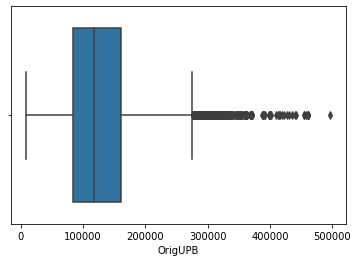

In [568]:
draw_boxplot('OrigUPB')

In [569]:
#drop outliers
upp,low=handle_outlier(data['OrigUPB'])

In [570]:
data['OrigUPB']=np.where(data['OrigUPB']>upp,upp,data['OrigUPB'])
data['OrigUPB']=np.where(data['OrigUPB']<low,low,data['OrigUPB'])

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



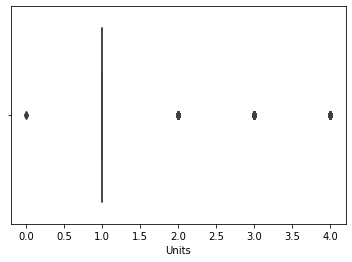

In [571]:
draw_boxplot('Units')

In [572]:
upper,lower=handle_outlier(data['Units'])

In [573]:
data['Units']=np.where(data['Units']>upper,upper,data['Units'])
data['Units']=np.where(data['Units']<lower,lower,data['Units'])

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



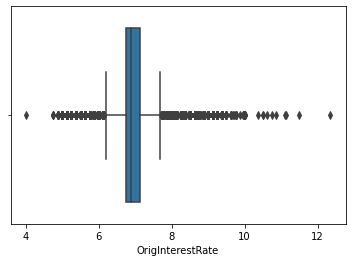

In [574]:
draw_boxplot('OrigInterestRate')

In [575]:
uppero,lowero=handle_outlier(data['OrigInterestRate'])

In [576]:
data['OrigInterestRate']=np.where(data['OrigInterestRate']>uppero,uppero,data['OrigInterestRate'])
data['OrigInterestRate']=np.where(data['OrigInterestRate']<lowero,lowero,data['OrigInterestRate'])

In [577]:
#checking for duplicates values to drop them
duplicate=data.duplicated()
print(duplicate.sum())

2138


In [578]:
data=data.drop_duplicates()

In [579]:
duplicate=data.duplicated()
print(duplicate.sum())

0


## New Data Visualisation 

<AxesSubplot:>

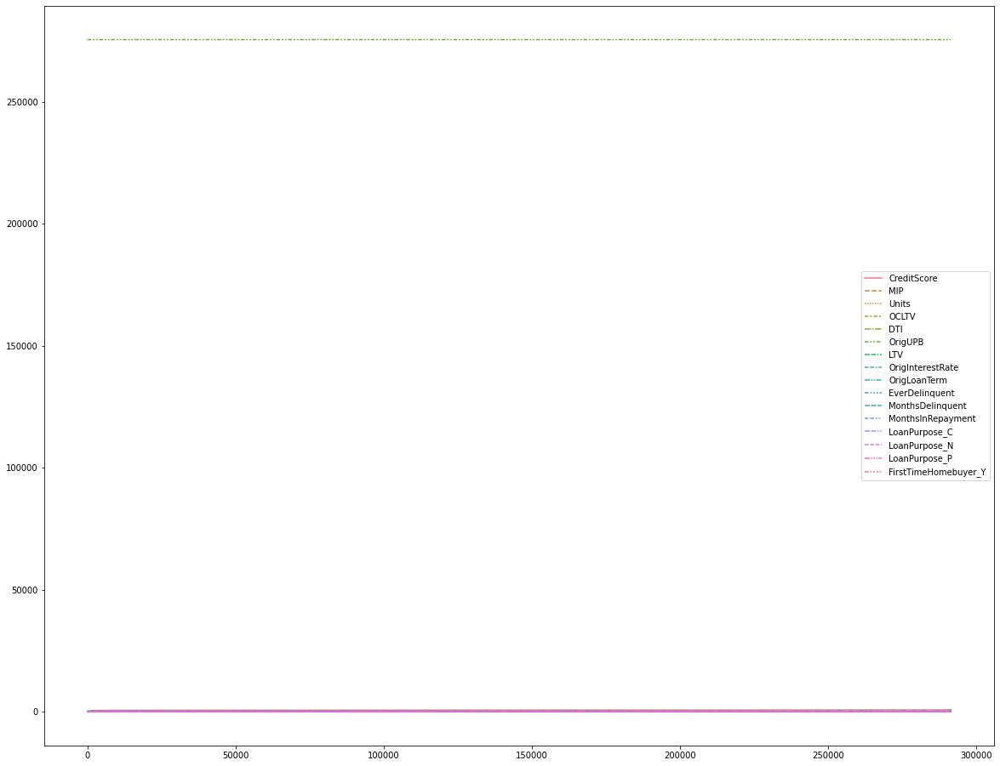

In [580]:
plt.figure(figsize=(20,16))
sns.lineplot(data=data)

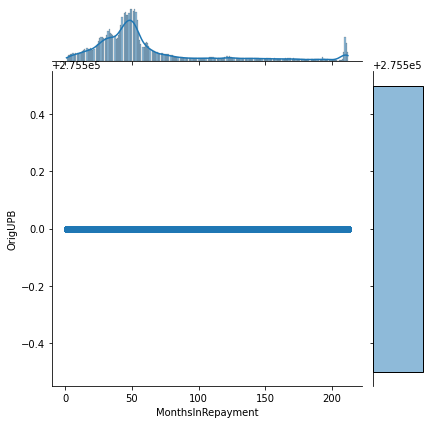

In [581]:
draw_join_plot(data['MonthsInRepayment'],data['OrigUPB'])

In [582]:
data['EverDelinquent'].unique()

array([0, 1])

In [583]:
data['EverDelinquent'].value_counts()

0    231680
1     57633
Name: EverDelinquent, dtype: int64

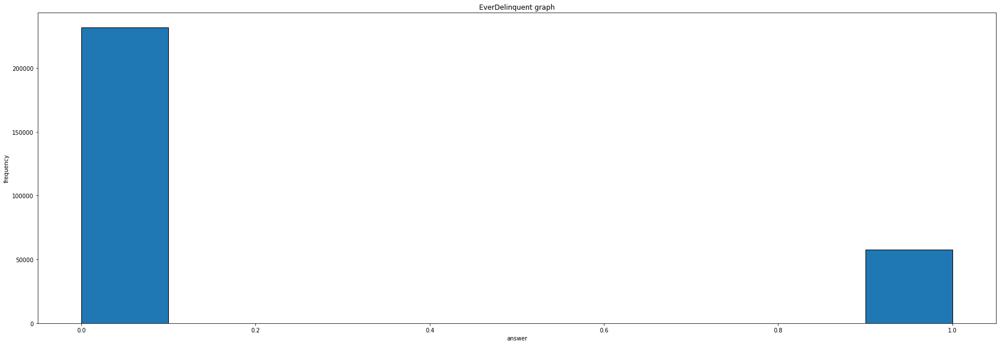

In [584]:
draw_histogram('EverDelinquent','EverDelinquent graph','answer','frequency')

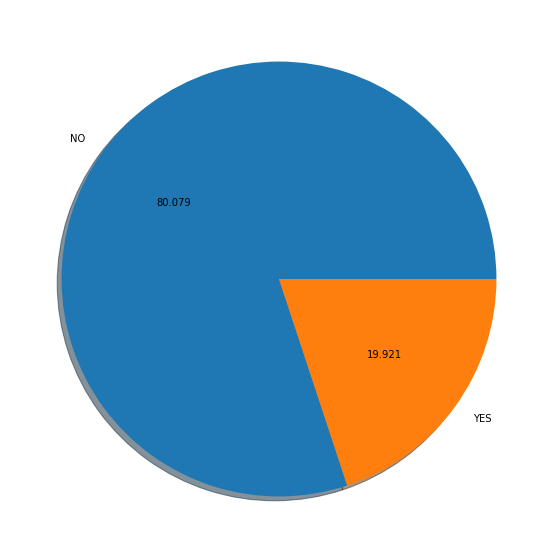

In [585]:
labels=['NO','YES']
draw_piechart('EverDelinquent',labels)

/usr/local/lib/python3.9/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



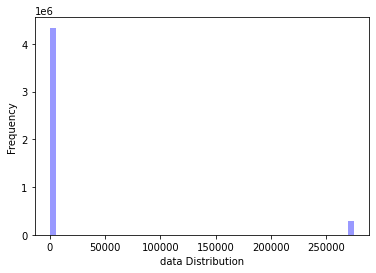

In [586]:
ax = sns.distplot(data,
                  kde=False,
                  color='blue')
ax.set(xlabel='data Distribution', ylabel='Frequency')
 
plt.show()

/usr/local/lib/python3.9/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



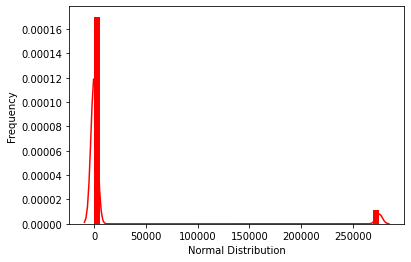

In [587]:
import scipy.stats as stats
ax = sns.distplot(data,
                  bins=50,
                  kde=True,
                  color='red',
                  hist_kws={"linewidth": 15,'alpha':1})
ax.set(xlabel='Normal Distribution', ylabel='Frequency')
 
plt.show()

In [588]:
#calculating z score to know how far from mean value (by calculating standard deviation)
#help you to know more about data
from scipy import stats
z_score=np.abs(stats.zscore(data))
print (z_score)

        CreditScore       MIP  Units     OCLTV       DTI  OrigUPB       LTV  \
0         10.362576  1.251897    NaN  0.793001  0.231585      NaN  0.795063   
1         10.362576  0.727358    NaN  0.255700  0.989403      NaN  0.254395   
2         10.362576  0.727358    NaN  0.124612  1.065184      NaN  0.123213   
3         10.362576  0.727358    NaN  0.059069  1.216748      NaN  0.057622   
4         10.362576  0.727358    NaN  0.072019  0.913621      NaN  0.073561   
...             ...       ...    ...       ...       ...      ...       ...   
291446     1.902391  0.727358    NaN  1.107769  0.147323      NaN  1.107079   
291447     1.917010  0.727358    NaN  0.255700  2.277692      NaN  0.254395   
291448     1.917010  0.727358    NaN  0.255700  0.071541      NaN  0.254395   
291449     1.990103  0.727358    NaN  0.203107  1.814521      NaN  0.204743   
291450     2.048577  0.727358    NaN  1.959838  0.080022      NaN  1.959764   

        OrigInterestRate  OrigLoanTerm  EverDelinqu

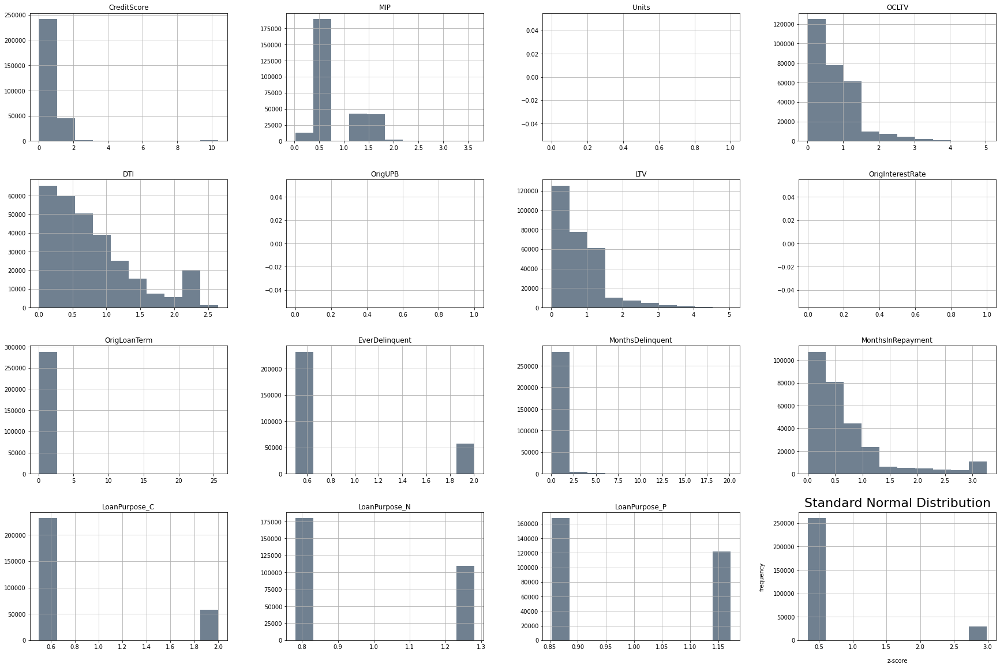

In [589]:
# view Standard Normal Distribution for all features 
z_score.hist(color='slategray',figsize=(30,20))
plt.title("Standard Normal Distribution", y=1.015, fontsize=22)
plt.xlabel("z-score", labelpad=14)
plt.ylabel("frequency", labelpad=14);


## Feature Extraction with PCA

In [590]:
import plotly.express as px
from sklearn.decomposition import PCA


n_components = 5

pca = PCA(n_components=n_components)
components = pca.fit_transform(data)

total_var = pca.explained_variance_ratio_.sum() * 100

labels = {str(i): f"PC {i+1}" for i in range(n_components)}
labels['color'] = 'Median Price'

fig = px.scatter_matrix(
    components,
    color=data['EverDelinquent'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%',
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [591]:
#that make a distribution of the data become clear

In [592]:
from pandas_profiling import ProfileReport

In [593]:
#Quick Recap of EDA 
profile=ProfileReport(data)
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Feature Engineering 

In [594]:
data.head()

,CreditScore,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,OrigLoanTerm,EverDelinquent,MonthsDelinquent,MonthsInRepayment,LoanPurpose_C,LoanPurpose_N,LoanPurpose_P,FirstTimeHomebuyer_Y
0,0,25,1.0,89,27,275500.0,89,7.6875,360,0,0,52,0,0,1,0
1,0,0,1.0,73,17,275500.0,73,7.6875,360,0,0,144,0,1,0,0
2,0,0,1.0,75,16,275500.0,75,7.6875,360,0,0,67,0,1,0,0
3,0,0,1.0,76,14,275500.0,76,7.6875,360,0,0,35,0,1,0,0
4,0,0,1.0,78,18,275500.0,78,7.6875,360,0,0,54,0,1,0,0


In [595]:
import pandas as pd

def calculate_credit_range(row):
    if row['CreditScore'] >= 750:
        return 'excellent'
    elif row['CreditScore'] >= 700:
        return 'good'
    elif row['CreditScore'] >= 650:
        return 'fair'
    else:
        return 'poor'
    
def calculate_ltv_range(row):
    if row['LTV'] < 75:
        return 'low'
    elif row['LTV'] >= 75 and row['LTV'] < 80:
        return 'medium'
    elif row['LTV'] >= 80 and row['LTV'] < 90:
        return 'high'
    else:
        return 'very high'
    
def calculate_repay_range(row):
    if row['OrigInterestRate'] < 4:
        return 'low'
    elif row['OrigInterestRate'] >= 4 and row['OrigInterestRate'] < 6:
        return 'medium'
    else:
        return 'high'

data['CreditRange'] = data.apply(calculate_credit_range, axis=1)
data['LTVRange'] = data.apply(calculate_ltv_range, axis=1)
data['RepayRange'] = data.apply(calculate_repay_range, axis=1)


# convert categorical ranges to numerical features
credit_range_dummies = pd.get_dummies(data['CreditRange'], prefix='CreditRange')
label_encoding('LTVRange')
repay_range_dummies = pd.get_dummies(data['RepayRange'], prefix='RepayRange')

# concatenate the newly created numerical features to the original data
raw_data = pd.concat([data, credit_range_dummies, repay_range_dummies], axis=1)

# drop the original categorical ranges
raw_data = raw_data.drop(['CreditRange', 'RepayRange'], axis=1)


In [596]:
raw_data.isnull().sum()

CreditScore              0
MIP                      0
Units                    0
OCLTV                    0
DTI                      0
OrigUPB                  0
LTV                      0
OrigInterestRate         0
OrigLoanTerm             0
EverDelinquent           0
MonthsDelinquent         0
MonthsInRepayment        0
LoanPurpose_C            0
LoanPurpose_N            0
LoanPurpose_P            0
FirstTimeHomebuyer_Y     0
LTVRange                 0
CreditRange_excellent    0
CreditRange_fair         0
CreditRange_good         0
CreditRange_poor         0
RepayRange_high          0
dtype: int64

In [597]:
data.drop(["MonthsInRepayment",'MonthsDelinquent'],axis=1,inplace=True)
raw_data.drop(["MonthsInRepayment",'MonthsDelinquent'],axis=1,inplace=True)
#because they are strongly corrolated with the target and causes data leakage (over fitting)

In [598]:
#Splitting data to features and label data 

In [599]:
raw_data.columns   

Index(['CreditScore', 'MIP', 'Units', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'OrigLoanTerm', 'EverDelinquent', 'LoanPurpose_C',
       'LoanPurpose_N', 'LoanPurpose_P', 'FirstTimeHomebuyer_Y', 'LTVRange',
       'CreditRange_excellent', 'CreditRange_fair', 'CreditRange_good',
       'CreditRange_poor', 'RepayRange_high'],
      dtype='object')

In [600]:
x=raw_data.drop(['EverDelinquent'], axis=1)
y=raw_data['EverDelinquent']

In [601]:
x.columns

Index(['CreditScore', 'MIP', 'Units', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'OrigLoanTerm', 'LoanPurpose_C', 'LoanPurpose_N',
       'LoanPurpose_P', 'FirstTimeHomebuyer_Y', 'LTVRange',
       'CreditRange_excellent', 'CreditRange_fair', 'CreditRange_good',
       'CreditRange_poor', 'RepayRange_high'],
      dtype='object')

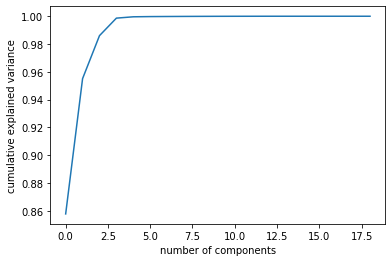

In [602]:
from sklearn.decomposition import PCA
pca = PCA().fit(x)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()


In [603]:
#Scalling feature data 

In [604]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
stat_data = scaler.fit_transform(x)


In [605]:
x.isnull().sum()

CreditScore              0
MIP                      0
Units                    0
OCLTV                    0
DTI                      0
OrigUPB                  0
LTV                      0
OrigInterestRate         0
OrigLoanTerm             0
LoanPurpose_C            0
LoanPurpose_N            0
LoanPurpose_P            0
FirstTimeHomebuyer_Y     0
LTVRange                 0
CreditRange_excellent    0
CreditRange_fair         0
CreditRange_good         0
CreditRange_poor         0
RepayRange_high          0
dtype: int64

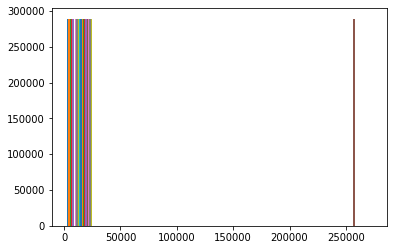

In [606]:
plt.hist(x)
plt.show()


In [607]:
!pip install category_encoders
#to install the needed liberary 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [608]:
x.corr()

,CreditScore,MIP,Units,OCLTV,DTI,OrigUPB,LTV,OrigInterestRate,OrigLoanTerm,LoanPurpose_C,LoanPurpose_N,LoanPurpose_P,FirstTimeHomebuyer_Y,LTVRange,CreditRange_excellent,CreditRange_fair,CreditRange_good,CreditRange_poor,RepayRange_high
CreditScore,1.000000,-0.164231,NaN,-0.191703,-0.097953,NaN,-0.191939,NaN,-0.008218,0.013017,-0.004887,-0.005742,-0.049522,-0.090964,0.553040,-0.277644,0.173184,-0.605578,NaN
MIP,-0.164231,1.000000,NaN,0.694339,0.110530,NaN,0.695445,NaN,0.014721,-0.326472,-0.154936,0.416634,0.264519,0.610330,-0.178515,0.103281,-0.007442,0.111063,NaN
Units,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
OCLTV,-0.191703,0.694339,NaN,1.000000,0.115357,NaN,0.999468,NaN,0.018321,-0.309954,-0.140204,0.388782,0.243288,0.394348,-0.232267,0.128816,0.018069,0.113190,NaN
DTI,-0.097953,0.110530,NaN,0.115357,1.000000,NaN,0.114973,NaN,0.028304,-0.003822,-0.063931,0.065903,0.056466,0.060414,-0.143619,0.092863,0.014413,0.048705,NaN
OrigUPB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LTV,-0.191939,0.695445,NaN,0.999468,0.114973,NaN,1.000000,NaN,0.018237,-0.310022,-0.140010,0.388647,0.243452,0.395537,-0.232337,0.128951,0.017811,0.113466,NaN
OrigInterestRate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
OrigLoanTerm,-0.008218,0.014721,NaN,0.018321,0.028304,NaN,0.018237,NaN,1.000000,0.016196,-0.032079,0.018397,0.014984,0.009831,-0.017640,0.007298,0.008531,0.001854,NaN
LoanPurpose_C,0.013017,-0.326472,NaN,-0.309954,-0.003822,NaN,-0.310022,NaN,0.016196,1.000000,-0.390316,-0.426481,-0.166940,-0.155517,-0.009031,0.012560,0.007734,-0.014929,NaN


In [609]:
x.isnull().sum()

CreditScore              0
MIP                      0
Units                    0
OCLTV                    0
DTI                      0
OrigUPB                  0
LTV                      0
OrigInterestRate         0
OrigLoanTerm             0
LoanPurpose_C            0
LoanPurpose_N            0
LoanPurpose_P            0
FirstTimeHomebuyer_Y     0
LTVRange                 0
CreditRange_excellent    0
CreditRange_fair         0
CreditRange_good         0
CreditRange_poor         0
RepayRange_high          0
dtype: int64

  ## Mutual Information

In [610]:
# Select the most important features 

In [611]:
import category_encoders as ce
from sklearn.feature_selection import SelectKBest , SelectPercentile , mutual_info_classif

In [612]:
from sklearn.feature_selection import mutual_info_classif as MIC
mi_score = MIC(x,y)
print(mi_score)

[3.58882283e-02 5.61301417e-03 4.84429308e-02 5.73739786e-03
 4.59125866e-03 6.38735923e-02 7.12597083e-03 3.49292459e-02
 5.16425169e-02 4.58077350e-03 1.75957827e-02 2.36163258e-02
 6.75149744e-06 1.31677035e-02 2.58936721e-02 1.19062983e-02
 1.99278486e-02 2.01765172e-02 4.87491874e-02]


In [613]:
from sklearn.feature_selection import chi2
best_features=SelectKBest(score_func=chi2,k=10)
fit=best_features.fit(x,y)
df_scores= pd.DataFrame(fit.scores_)
df_col=pd.DataFrame(x.columns)
features_score =pd.concat([df_col,df_scores], axis=1)
features_score.columns=['feature','score']
features_score.sort_values(by=['score'],ascending=False)

,feature,score
0,CreditScore,82313.364214
1,MIP,18965.503893
17,CreditRange_poor,10713.083319
4,DTI,6351.661197
14,CreditRange_excellent,5646.301434
6,LTV,4025.526627
3,OCLTV,4004.643940
15,CreditRange_fair,2039.242517
16,CreditRange_good,1383.901767
13,LTVRange,297.554751


In [614]:
selector=SelectKBest(mutual_info_classif,k=15)
x_selected=selector.fit_transform(x,y)
cols=selector.get_support(indices=True)
selected_features = x.iloc[:,cols].columns.tolist()
selected_features

['CreditScore',
 'MIP',
 'Units',
 'OrigUPB',
 'LTV',
 'OrigInterestRate',
 'OrigLoanTerm',
 'LoanPurpose_N',
 'LoanPurpose_P',
 'LTVRange',
 'CreditRange_excellent',
 'CreditRange_fair',
 'CreditRange_good',
 'CreditRange_poor',
 'RepayRange_high']

In [615]:
from sklearn.ensemble import ExtraTreesClassifier
model=ExtraTreesClassifier()
model.fit(x,y)
print(model.feature_importances_)

[0.38360236 0.01827288 0.         0.05554139 0.39300607 0.
 0.05518328 0.         0.00434485 0.00084764 0.00098865 0.00112874
 0.00275348 0.00377332 0.02102837 0.01156131 0.01105272 0.03691494
 0.        ]


In [616]:
#view feature importance

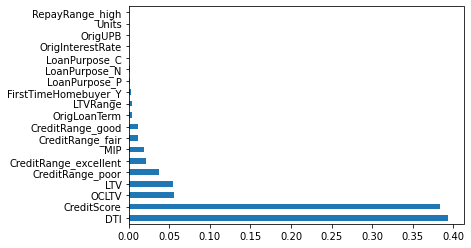

In [617]:
feat_imp=pd.Series(model.feature_importances_,index=x.columns)
feat_imp.nlargest(20).plot(kind='barh')
plt.show()

In [618]:
from sklearn.feature_selection import mutual_info_regression
discrete_features = x.dtypes == int
def make_mi_scores(X, y):
    mi_scores = mutual_info_regression(X, y, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

mi_scores = make_mi_scores(x, y)
mi_scores[::] 

OrigUPB                  0.047029
CreditScore              0.039261
CreditRange_poor         0.017997
CreditRange_excellent    0.015751
OrigLoanTerm             0.007617
MIP                      0.005908
CreditRange_fair         0.004090
LTVRange                 0.003133
OCLTV                    0.003002
LTV                      0.002861
CreditRange_good         0.002225
LoanPurpose_N            0.002003
RepayRange_high          0.000422
DTI                      0.000201
OrigInterestRate         0.000128
LoanPurpose_C            0.000085
FirstTimeHomebuyer_Y     0.000000
LoanPurpose_P            0.000000
Units                    0.000000
Name: MI Scores, dtype: float64

In [619]:
raw_data.columns

Index(['CreditScore', 'MIP', 'Units', 'OCLTV', 'DTI', 'OrigUPB', 'LTV',
       'OrigInterestRate', 'OrigLoanTerm', 'EverDelinquent', 'LoanPurpose_C',
       'LoanPurpose_N', 'LoanPurpose_P', 'FirstTimeHomebuyer_Y', 'LTVRange',
       'CreditRange_excellent', 'CreditRange_fair', 'CreditRange_good',
       'CreditRange_poor', 'RepayRange_high'],
      dtype='object')

In [620]:
#Select best features after PCA

In [621]:
import pandas as pd
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_regression


# Define the number of top features to select
N = 11

# Select top N features based on mutual information
selector = SelectKBest(score_func=mutual_info_regression, k=N)
X_selected = selector.fit_transform(x, y)

# Get the indices of the selected features
selected_feature_indices = selector.get_support(indices=True)

# Get the names of the selected features
selected_features = x.columns[selected_feature_indices].tolist()



In [622]:
df_selected = pd.DataFrame(X_selected)

df_selected.dtypes

0     float64
1     float64
2     float64
3     float64
4     float64
5     float64
6     float64
7     float64
8     float64
9     float64
10    float64
dtype: object

In [623]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x= scaler.fit_transform(x)


In [624]:
pca=PCA(n_components=6)
pca.fit(x)
features=pca.transform(x)

## Modelling

In [625]:
from sklearn.model_selection import train_test_split


# separate features and labels
import pandas as pd
df_selected = pd.DataFrame(X_selected)
# features = df_selected

df_labels = pd.DataFrame(y)
labels = df_labels["EverDelinquent"]


# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, 
    test_size=0.25, random_state= 8) 


print("X_train shape: {}".format(X_train.shape))
print("X_test shape: {}".format(X_test.shape))
print("y_train shape: {}".format(y_train.shape))
print("y_test shape: {}".format(y_test.shape))
print("X_val shape: {}".format(y_train.shape))
print("y val shape: {}".format(y_test.shape))


X_train shape: (173587, 6)
X_test shape: (57863, 6)
y_train shape: (173587,)
y_test shape: (57863,)
X_val shape: (173587,)
y val shape: (57863,)


In [626]:
features.shape

(289313, 6)

In [627]:
labels.shape

(289313,)

In [628]:
labels.value_counts()

0    231680
1     57633
Name: EverDelinquent, dtype: int64

In [629]:
from imblearn.over_sampling import SMOTE
oversampled = SMOTE(random_state=0)
X_train_smote, y_train_smote = oversampled.fit_resample(X_train, y_train)

In [630]:
y_train_smote.value_counts()

0    139060
1    139060
Name: EverDelinquent, dtype: int64

## Random Forest Model 

In [631]:
from sklearn.ensemble import RandomForestClassifier

In [632]:

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score



# Train the random forest classifier
rf = RandomForestClassifier(n_estimators=2)
rf.fit(X_train_smote, y_train_smote)

# Make predictions on the test set
y_pred = rf.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)


Accuracy: 0.7120785303216217


In [633]:
#Testing Accuracy
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

y_pred_test = rf.predict(X_test)
y_pred_test[0:5]


testing_accuracy = accuracy_score(y_test,y_pred_test)*100
print('Testing data accuracy is:', testing_accuracy)
print()

clf_report = classification_report(y_test,y_pred_test)
print('Classification report:\n', clf_report)
print()

confusion_matrix(y_test,y_pred_test)

Testing data accuracy is: 71.20785303216218

Classification report:
               precision    recall  f1-score   support

           0       0.82      0.83      0.82     46273
           1       0.27      0.25      0.26     11590

    accuracy                           0.71     57863
   macro avg       0.54      0.54      0.54     57863
weighted avg       0.71      0.71      0.71     57863




array([[38269,  8004],
       [ 8656,  2934]])

In [634]:
#Training Accuracy

y_pred_train = rf.predict(X_train)
y_pred_train


training_accuracy = accuracy_score(y_train,y_pred_train)*100
print('training data accuracy is:', training_accuracy)
print()

clf_report = classification_report(y_train,y_pred_train)
print('Classification report:\n', clf_report)
print()

confusion_matrix(y_train,y_pred_train)

training data accuracy is: 90.3155190192814

Classification report:
               precision    recall  f1-score   support

           0       0.93      0.95      0.94    139060
           1       0.79      0.70      0.74     34527

    accuracy                           0.90    173587
   macro avg       0.86      0.83      0.84    173587
weighted avg       0.90      0.90      0.90    173587




array([[132571,   6489],
       [ 10322,  24205]])

In [635]:
accuracy_score(y_test,y_pred)

0.7120785303216217

In [636]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,y_pred)

0.5400879131870098

## SVC Model (Support Vector Machine)

In [637]:
from sklearn import metrics
from sklearn.svm import LinearSVC
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [638]:
model=LinearSVC()
model.fit(X_train_smote, y_train_smote)
train_pred=model.predict(X_train)
y_preds=model.predict(X_test)

print(f"Training score = {metrics.accuracy_score(y_train,train_pred)}")
print(f"Testing score = {metrics.accuracy_score(y_test,y_preds)}")


Training score = 0.6575261972382724
Testing score = 0.6578469833918048


/usr/local/lib/python3.9/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



In [639]:


training_accuracy = accuracy_score(y_train,train_pred)*100
print('training data accuracy is:', training_accuracy)
print()

clf_report = classification_report(y_train,train_pred)
print('Classification report:\n', clf_report)
print()

confusion_matrix(y_train,train_pred)

training data accuracy is: 65.75261972382724

Classification report:
               precision    recall  f1-score   support

           0       0.88      0.67      0.76    139060
           1       0.32      0.62      0.42     34527

    accuracy                           0.66    173587
   macro avg       0.60      0.64      0.59    173587
weighted avg       0.76      0.66      0.69    173587




array([[92866, 46194],
       [13255, 21272]])

In [640]:
confusion_matrix(y_test,y_preds)

array([[30901, 15372],
       [ 4426,  7164]])

In [641]:
accuracy_score(y_test,y_preds)

0.6578469833918048

In [642]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,y_preds)

0.6429583519662644

SVC works well with the data but this is not the best accuracy 

## Decision tree classifier

In [643]:
from sklearn.tree import DecisionTreeClassifier

In [644]:
model_d= DecisionTreeClassifier(criterion="entropy",max_depth=10,random_state=44,ccp_alpha=0.8,min_impurity_decrease=0.6)

# Train Decision Tree Classifer
model_d = model_d.fit(X_train_smote, y_train_smote)
y_train_pred=model_d.predict(X_train)
#Predict the response for test dataset
y_pred_test = model_d.predict(X_test)

In [645]:
print("Accuracy:",metrics.accuracy_score(y_train,y_train_pred))

Accuracy: 0.8010968563314073


In [646]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test,y_pred_test))

Accuracy: 0.7996992897015364


In [647]:

training_accuracy = accuracy_score(y_train,y_train_pred)*100
print('training data accuracy is:', training_accuracy)
print()

clf_report2 = classification_report(y_train,y_train_pred)
print('Classification report:\n', clf_report2)
print()


training data accuracy is: 80.10968563314073



/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Classification report:
               precision    recall  f1-score   support

           0       0.80      1.00      0.89    139060
           1       0.00      0.00      0.00     34527

    accuracy                           0.80    173587
   macro avg       0.40      0.50      0.44    173587
weighted avg       0.64      0.80      0.71    173587




/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [648]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,y_pred_test)

0.5

decision tree make the highest accuracy than the previous two algorithms 

we should choose the model which has the highest auc curve and more sharp after test so we chose random forest to deploy 

#Deployment 


In [649]:
import joblib
joblib.dump(rf,'model.joblib')
#save the random forest model using joblib

['model.joblib']

In [650]:
# save the pca using joblib
joblib.dump(pca,'pca.joblib')

['pca.joblib']

In [ ]:
#save the scaler object to do normalization to user input 
dump(scaler,'scaler.joblib')